# Integrated dataset plots

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os,sys
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import scipy.sparse
import anndata
import seaborn as sns
import scvelo as scv

In [3]:
figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/embedding_figures/"
if os.path.exists(figdir):
    sc.settings.figdir = figdir
    scv.settings.figdir = figdir
else:
    os.mkdir(figdir)
    sc.settings.figdir = figdir
    scv.settings.figdir = figdir
    
sc.set_figure_params(vector_friendly=True, fontsize=18)
scv.set_figure_params(vector_friendly=True, fontsize=18)

In [4]:
## r2py setup
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

anndata2ri.activate()

In [5]:
%load_ext rpy2.ipython


In [6]:
%%R
library(tidyverse)
library(reshape2)
library(patchwork)

remove_x_axis <- function(){
  theme(axis.text.x = element_blank(), axis.ticks.x = element_blank(), axis.title.x = element_blank())  
}

remove_y_axis <- function(){
  theme(axis.text.y = element_blank(), axis.ticks.y = element_blank(), axis.title.y = element_blank())  
}

In [7]:
### Load data

data_dir = '/nfs/team205/ed6/data/Fetal_immune/'
timestamp = '20210429'

In [8]:
adata = sc.read_h5ad('{d}PAN.A01.v01.entire_data_normalised_log.{t}.h5ad'.format(d=data_dir, t=timestamp))

### Load results from scVI

def load_scvi_outs(adata, emb_file):
    X_scVI_emb = np.load(emb_file)
    X_scVI_umap = np.load(emb_file.rstrip(".npy") + ".UMAP.npy")
    X_scVI_clust = pd.read_csv(emb_file.rstrip(".npy") + ".clustering.csv", index_col=0)
    adata.obsm["X_scvi"] = X_scVI_emb
    adata.obsm["X_umap"] = X_scVI_umap
    adata.obs["scvi_clusters"] = X_scVI_clust.loc[adata.obs_names]["leiden_150"].astype("category")

load_scvi_outs(adata, data_dir + "scVI_outs/PAN.A01.v01.entire_data_raw_count.{t}.scVI_out.npy".format(t=timestamp))

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


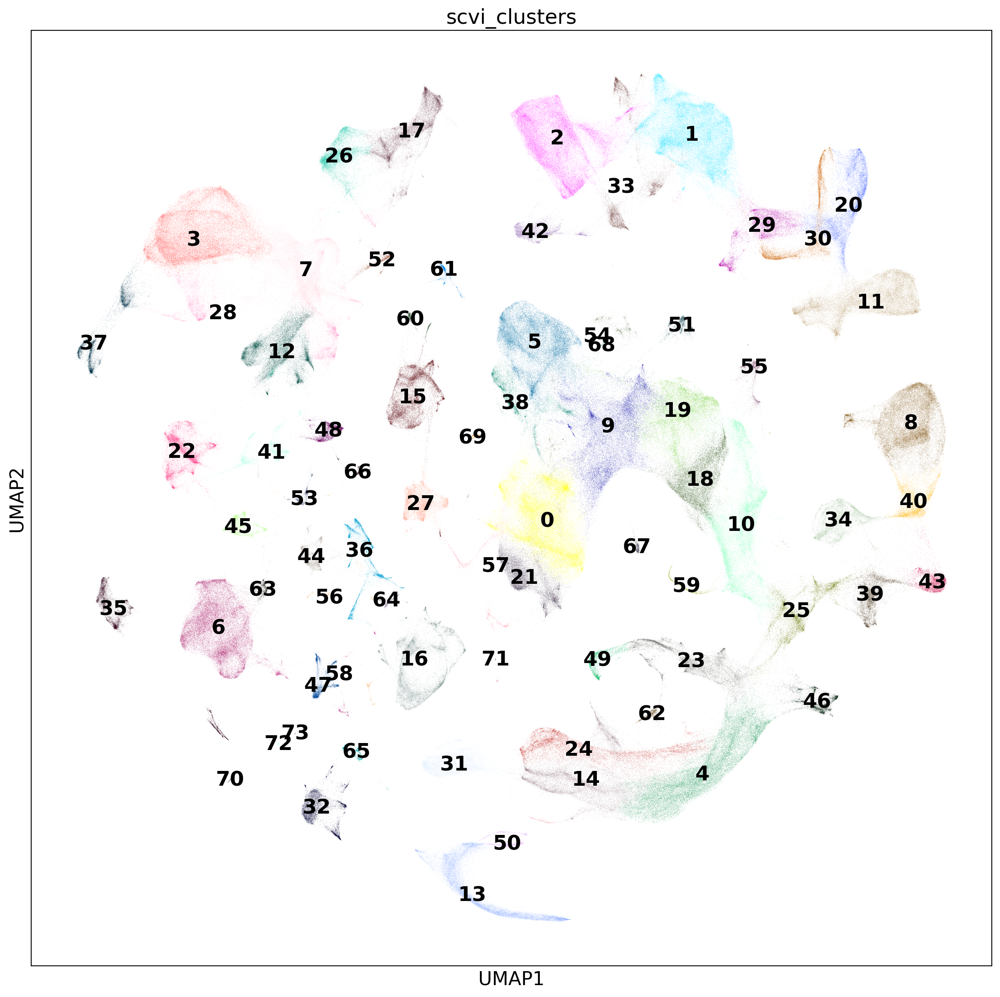

In [9]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.umap(adata, color="scvi_clusters", legend_loc="on data")

In [10]:
## Filter maternal contaminants
mat_barcodes = pd.read_csv("../../metadata/souporcell_results/maternal_barcodes.csv", index_col=0)
mat_barcodes["x"] = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])

### Load annotations

In [27]:
anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)
obs_cols = anno_obs.columns.copy()
anno_obs = anno_obs.drop(['sex'], 1)
anno_obs = anno_obs.drop(['Sort_id'], 1)

In [28]:
new_meta = pd.read_csv('/home/jovyan/mount/gdrive/Pan_fetal/writing/revision/supplementary tables/Table_S6.csv', index_col=0)

In [29]:
new_meta['Sample.lanes'] = new_meta['File'].copy()

In [30]:
obs_names = anno_obs.index.copy()

In [31]:
anno_obs = pd.merge(anno_obs, new_meta, how='left')
anno_obs['sex'] = anno_obs['Sex'].copy()

# anno_obs.index = obs_names

In [32]:
assert all(anno_obs['Organ'] == anno_obs['organ'])
assert all(anno_obs['Age'] == anno_obs['age'])

In [33]:
anno_obs = anno_obs[obs_cols].copy()

In [34]:
anno_obs.index = obs_names

In [47]:
anno_obs.to_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv")


In [48]:
data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv"

'/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv'

#### Save for data sharing

In [101]:
adata.var_names_make_unique()

## Mark maternal contaminants
adata.obs['is_maternal_contaminant'] = adata.obs_names.isin(mat_barcodes)

## Add fine cell type annotations and other metadata cols
add_metadata_cols = ['organ',
                 'Sort_id', 'age', 'method', 'donor', 'sex','uniform_label_expanded_merged',
                 'Sample','anno_lvl_2_final_clean']
for col in add_metadata_cols:
    adata.obs[col] = np.nan
    adata.obs.loc[adata.obs_names.isin(anno_obs.index), col] = anno_obs.loc[adata.obs_names[adata.obs_names.isin(anno_obs.index)]][col]

## Rename some obs columns
adata.obs['celltype_annotation'] = adata.obs['anno_lvl_2_final_clean'].copy()
adata.obs['old_annotation_uniform'] = adata.obs['uniform_label_expanded_merged'].copy()

keep_obs_cols = ['n_counts', 
                 'n_genes', 
                 'file', 
                 'mito', 
                 'doublet_scores',
                 'predicted_doublets', 
                 'old_annotation_uniform', 
                 'organ',
                 'Sort_id', 'age', 'method', 'donor', 'sex',
                 'Sample', 
                 'scvi_clusters', 
                 'is_maternal_contaminant',
                 'anno_lvl_2_final_clean', 
                 'celltype_annotation']

In [102]:
adata

AnnData object with n_obs × n_vars = 911873 × 33538
    obs: 'n_counts', 'n_genes', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'leiden_150', 'scvi_clusters', 'is_maternal_contaminant', 'organ', 'Sort_id', 'age', 'method', 'donor', 'sex', 'uniform_label_expanded_merged', 'Sample', 'anno_lvl_2_final_clean', 'celltype_annotation', 'old_annotation_uniform'
    var: 'GeneID', 'GeneName'
    uns: 'leiden', 'scvi', 'umap', 'scvi_clusters_colors'
    obsm: 'X_scvi', 'X_umap'
    obsp: 'scvi_connectivities', 'scvi_distances'

In [ ]:
adata.obs = adata.obs[keep_obs_cols].copy()
adata.obs["donor"] = adata.obs["donor"].astype(str) ## Fix mixed type issue

## Clean uns
adata.uns = {k:v for k,v in adata.uns.items() if not k.endswith("_colors")}

## Store the raw count matrix
adata_raw = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_raw_count.{t}.h5ad'.format(t=timestamp))
adata.X = adata_raw.X.copy()
del adata_raw

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [ ]:
output_dir = data_dir + 'cellxgene_h5ad_files/scRNA_data/'
## Save info on vars used in scVI embedding 
adata_var = pd.read_csv(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.var.csv'.format(t=timestamp), index_col=0)
scvi_model_vars = pd.read_csv(output_dir + '/scVI_models/scvi_PFI_model/var_names.csv', header=None)[0]
adata_var['scvi_model_var'] = adata_var['GeneID'].isin(scvi_model_vars)
adata.var = adata_var.copy()

adata.write_h5ad(output_dir + 'PAN.A01.v01.raw_count.{t}.{s}.embedding.h5ad'.format(t=timestamp, s="PFI"), compression='gzip')

In [ ]:
import gc
gc.collect()

In [ ]:
# log normalize
sc.pp.normalize_per_cell(adata, counts_per_cell_after=10e4)
sc.pp.log1p(adata)
# Remove unnecessary components
adata.uns = {}
adata.obsp = {}
del adata.obsm['X_scvi']
adata.write_h5ad(output_dir + 'PAN.A01.v01.raw_count.{t}.{s}.embedding.cellxgene.h5ad'.format(t=timestamp, s="PFI"))

## Organ/age distribution

In [39]:
## Read annotation groupings
import json
with open('../../metadata/anno_groups.json', 'r') as json_file:
    anno_groups_dict = json.load(json_file)
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}

In [40]:
adata = adata[(~adata.obs_names.isin(mat_barcodes["x"])) & (adata.obs_names.isin(anno_obs.index))]
adata.obs = anno_obs.loc[adata.obs_names].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [41]:
adata.obs[adata.obs['donor'] == 'F64']

,n_counts,n_genes,file,mito,doublet_scores,predicted_doublets,name,uniform_label,uniform_label_expanded_merged,uniform_label_lvl0,...,Sample.lanes,Sort_id,age,method,donor,sex,Processing_method,AnnatomicalPart,Sample,anno_lvl_2_final_clean
FCAImmP7851890-AGCTCCTGTCGCTTCT,62409.0,6517,FCAImmP7851890,0.024628,0.243243,False,FCAImmP7851890_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851890,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851890,TREG
FCAImmP7851890-GTCCTCACAGTACACT,51566.0,6848,FCAImmP7851890,0.028876,0.107438,False,FCAImmP7851890_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851890,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851890,DP(P)_T
FCAImmP7851890-TGCTGCTAGAAGATTC,51016.0,6676,FCAImmP7851890,0.032362,0.141153,False,FCAImmP7851890_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851890,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851890,DP(P)_T
FCAImmP7851890-TACGGTACATGTCTCC,45741.0,6445,FCAImmP7851890,0.025448,0.215259,False,FCAImmP7851890_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851890,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851890,DP(P)_T
FCAImmP7851890-CAGAGAGCACGCATCG,45044.0,6182,FCAImmP7851890,0.025997,0.073879,False,FCAImmP7851890_filtered.h5ad,DN T CELL,DN T CELL,LYMPHOID,...,FCAImmP7851890,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851890,DN(P)_T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FCAImmP7851891-TGTTCCGTCTATCGCC,2006.0,1043,FCAImmP7851891,0.011964,0.320755,False,FCAImmP7851891_filtered.h5ad,DN T CELL,DN T CELL,LYMPHOID,...,FCAImmP7851891,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851891,DN(Q)_T
FCAImmP7851891-GCAATCAAGACTAGGC,2005.0,1062,FCAImmP7851891,0.002494,0.117338,False,FCAImmP7851891_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851891,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851891,ABT(ENTRY)
FCAImmP7851891-TAAGCGTAGTACATGA,2008.0,872,FCAImmP7851891,0.004482,0.043922,False,FCAImmP7851891_filtered.h5ad,DP T CELL,DP T CELL,LYMPHOID,...,FCAImmP7851891,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851891,DP(Q)_T
FCAImmP7851891-ACTTACTAGGGTGTGT,2008.0,937,FCAImmP7851891,0.002490,0.020505,False,FCAImmP7851891_filtered.h5ad,SP T CELL,SP T CELL,LYMPHOID,...,FCAImmP7851891,TOT,11,5GEX,F64,male,Collagnase,unknown,F64_TH_TOT_FCAImmP7851891,ABT(ENTRY)


In [79]:
org_count_df = anno_obs.groupby(["organ", "anno_lvl_2_final_clean"]).count()['file'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
org_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in org_count_df.anno_lvl_2_final_clean]
org_count_df.loc[org_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
org_count_df["anno"] = org_count_df["anno_lvl_2_final_clean"]

In [80]:
org_colors = pd.read_csv("../../metadata/organ_colors.csv", index_col=0)

In [81]:
age_count_df = anno_obs.groupby(["age", "anno_lvl_2_final_clean"]).count()['file'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
age_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in age_count_df.anno_lvl_2_final_clean]
age_count_df.loc[age_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
age_count_df["anno"] = age_count_df["anno_lvl_2_final_clean"]

In [82]:
%%R -i age_count_df --i figdir -w 800 -h 1000
order_groups <-  c('PROGENITORS', 'ERYTHROID CELLS','MYELOID', 'B CELLS', 'ILC', 'NK/T CELLS', 'STROMA','OTHER')

age_pl_df <- age_count_df %>%
#     mutate(anno_group= ifelse(anno=="INTERSTITIAL CELLS OF CAJAL", "STROMA", anno_group)) %>%
#     mutate(anno_group= ifelse(anno=="LOW_Q_INCONSISTENT", "OTHER", anno_group)) %>%
    rename(N_cells = file) %>%
    group_by(anno) %>%
    mutate(max_age = age[which.max(N_cells)])  %>% ## At which age there are most cells?
    mutate(min_age = min(age[which(N_cells > 10)]))  %>%
    ungroup() %>%
    arrange(- max_age) %>%
    mutate(anno=factor(anno, levels=unique(anno))) %>%
    mutate(anno_group = factor(anno_group, levels=order_groups))
    
pl1 <- age_pl_df %>%
    ggplot(aes(anno, N_cells)) + 
    geom_col(aes(fill=age),position="fill", width=0.8) +
    coord_flip() +
    facet_grid(anno_group~., space="free", scales="free") +
    scale_fill_viridis_c() +
    theme_bw(base_size=16) +
    theme(strip.text.y=element_text(angle=0)) +
    ylab("fraction of cells") + xlab("") +
    expand_limits(y = 1.2) +
    geom_text(data=. %>% group_by(anno) %>% 
              summarise(N_cells=sum(N_cells), anno_group=first(anno_group)),
              hjust=0,
              y=1.01, aes(label=paste("N =", N_cells))
             ) +
    ggsave(paste0(figdir, "age_distribution.pdf"), height=20, width=12) +
    ggsave(paste0(figdir, "age_distribution.png"), height=20, width=12) 

In [83]:
%%R -i org_count_df -i org_colors -i figdir -w 800 -h 1000
org_palette <- setNames(org_colors$color, rownames(org_colors))

pl2 <- org_count_df %>%
    rename(N_cells = file) %>%
    mutate(anno=factor(anno, levels=levels(age_pl_df$anno))) %>%
    mutate(anno_group = factor(anno_group, levels=order_groups)) %>%
    mutate(organ=factor(organ, levels=rownames(org_colors))) %>%
    ggplot(aes(anno, N_cells)) + 
    geom_col(aes(fill=organ) ,position="fill", width=0.8) +
    coord_flip() +
    facet_grid(anno_group~., space="free", scales="free") +
    scale_fill_manual(values=org_palette) +
    theme_bw(base_size=16) +
    theme(strip.text.y=element_text(angle=0)) +
    ylab("fraction of cells") + xlab("") +
#     expand_limits(y = 1.2) +
#     geom_text(data=. %>% group_by(anno) %>% 
#               summarise(N_cells=sum(N_cells), anno_group=first(anno_group)),
#               hjust=0,
#               y=1.01, aes(label=paste("N =", N_cells))
#              ) +
    ggsave(paste0(figdir, "organ_distribution.pdf"), height=20, width=12) +
    ggsave(paste0(figdir, "organ_distribution.png"), height=20, width=12) 

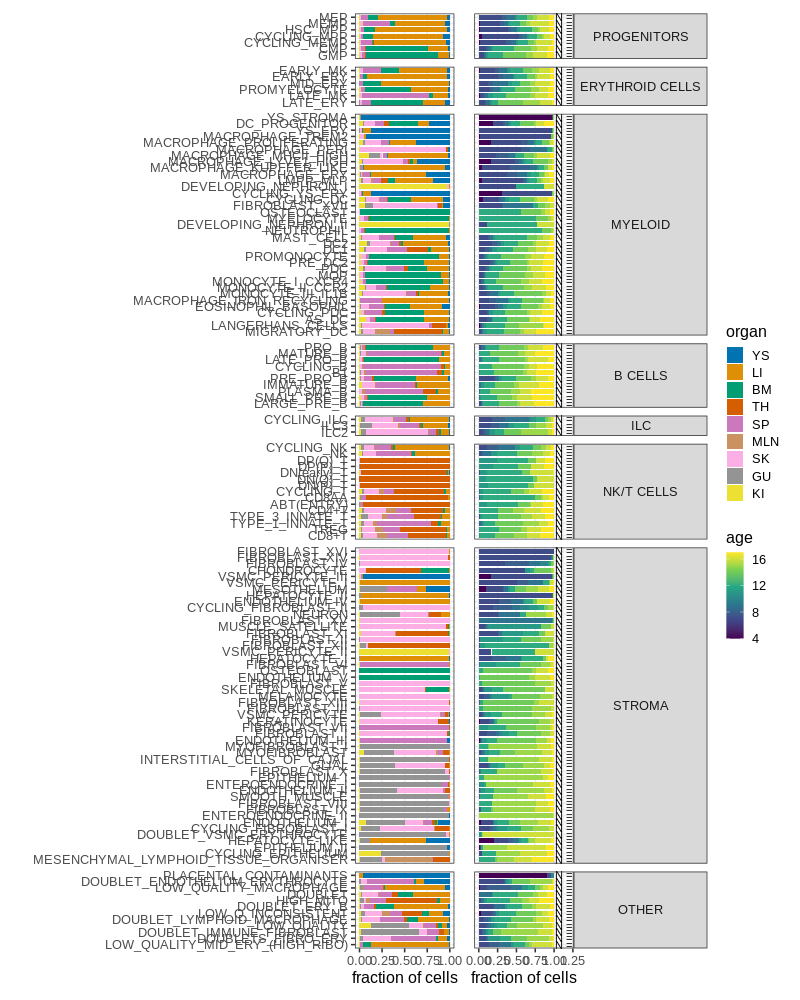

In [84]:
%%R -w 800 -h 1000
((pl2 + theme( strip.background = element_blank(),strip.text.y = element_blank())) | pl1 + remove_y_axis()) +
plot_layout(guides='collect') +
    ggsave(paste0(figdir, "organ_age_distribution.pdf"), height=22, width=18) +
    ggsave(paste0(figdir, "organ_age_distribution.png"), height=22, width=18) 

In [85]:
org_count_df = anno_obs.groupby(["organ",'donor', "anno_lvl_2_final_clean"]).count()['file'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
org_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in org_count_df.anno_lvl_2_final_clean]
org_count_df.loc[org_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
org_count_df["anno"] = org_count_df["anno_lvl_2_final_clean"]

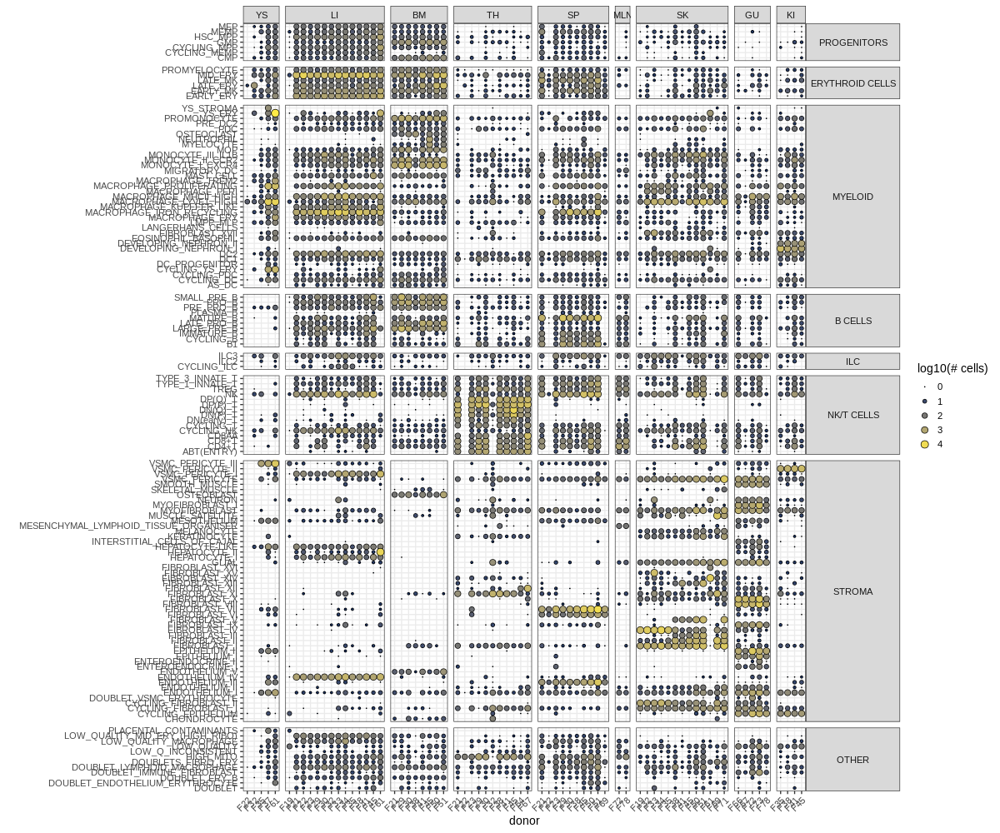

In [86]:
%%R -i org_count_df --i figdir -w 1200 -h 1000 -i org_colors
pl3 <- org_count_df %>%
    rename(N_cells=file) %>%
    mutate(organ=factor(organ, levels=rownames(org_colors))) %>%
    mutate(anno=factor(anno, levels=levels(age_pl_df$anno))) %>%
    mutate(anno_group = factor(anno_group, levels=order_groups)) %>%
  ggplot(aes(donor, anno_lvl_2_final_clean)) +
    geom_point(aes(fill=log10(N_cells), size=log10(N_cells)), shape=21) +
    facet_grid(anno_group~organ, space="free", scales="free") +
    scale_fill_viridis_c(option='cividis', guide = "legend", name='log10(# cells)') +
    scale_size(range=c(0,4), name='log10(# cells)') +
    theme_bw(base_size=14) +
    xlab("donor") + ylab("") +
    theme(strip.text.y=element_text(angle=0), axis.text.x=element_text(angle=45, vjust=1, hjust=1)) 
    
pl3 +
    ggsave(paste0(figdir, "donor_distribution.pdf"), height=22, width=22) +
    ggsave(paste0(figdir, "donor_distribution.png"), height=22, width=22) 

## UMAP by lineage

In [24]:
adata.obs["anno_group"] = [anno_groups_dict_rev[x] for x in adata.obs["anno_lvl_2_final_clean"]]

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [25]:
print("No. of low quality cells: "+str(sum(adata.obs['anno_group'] == "OTHER")))

No. of low quality cells: 23110


In [26]:
sum(adata.obs['anno_group'] == "OTHER")/adata.n_obs

0.02561022369882111

In [27]:
adata.obs[adata.obs['anno_group'] != "OTHER"]['anno_lvl_2_final_clean'].unique().shape

(126,)

... storing 'file' as categorical
... storing 'name' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'organ' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'Sample' as categorical
... storing 'anno_lvl_2_final_clean' as categorical
... storing 'anno_group' as categorical


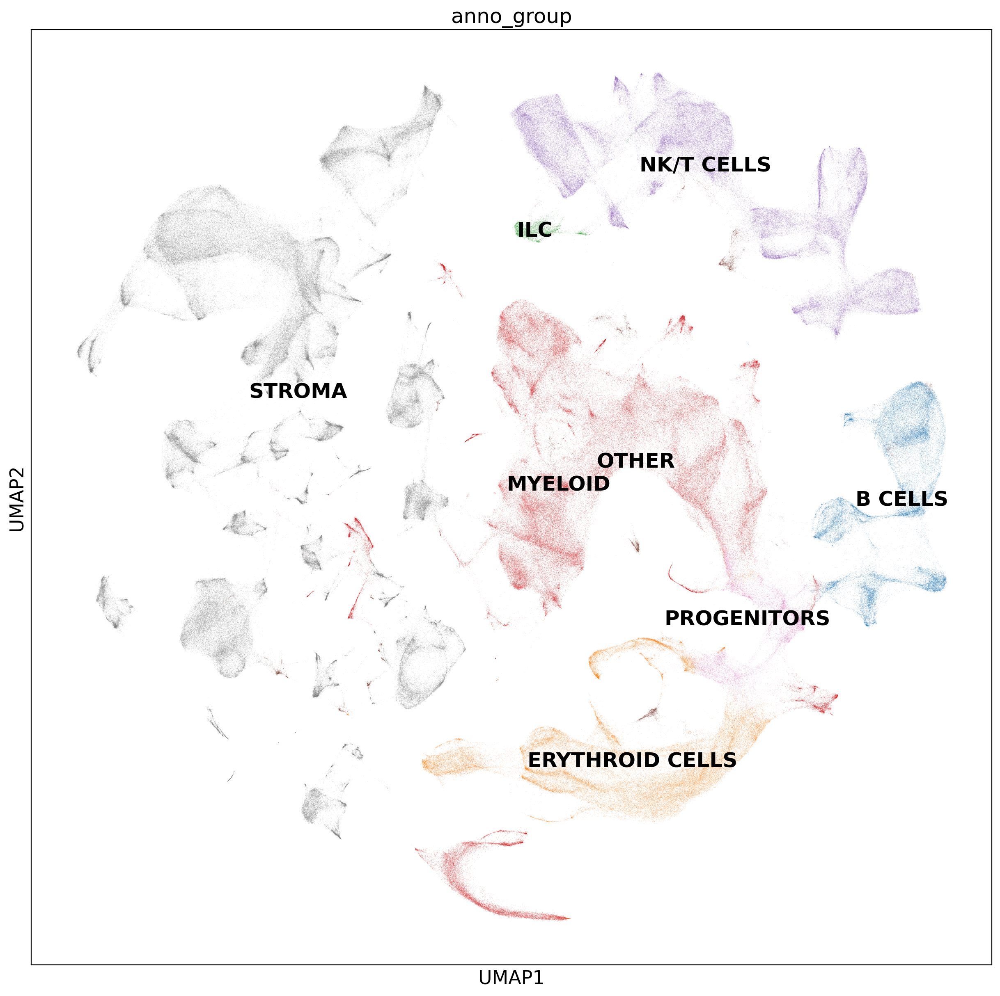

In [21]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.umap(adata, color="anno_group", legend_loc="on data")

In [28]:
import copy
anno_groups_lvl0 = copy.deepcopy(anno_groups_dict)

anno_groups_lvl0["FIBROBLASTS"] = [x for x in anno_groups_dict["STROMA"] if "FIBROBLAST" in x]
anno_groups_lvl0["ENDOTHELIUM"] = [x for x in anno_groups_dict["STROMA"] if "ENDOTHELIUM" in x]
anno_groups_lvl0["SMOOTH MUSCLE"] = [x for x in anno_groups_dict["STROMA"] if "VSMC" in x]
anno_groups_lvl0["SMOOTH MUSCLE"].append("SMOOTH_MUSCLE")
anno_groups_lvl0["SKELETAL MUSCLE"] = ['MUSCLE_SATELLITE', 'SKELETAL_MUSCLE']
anno_groups_lvl0["MEGAKARYOCYTE"] = [x for x in anno_groups_dict["ERYTHROID CELLS"] if "MK" in x]
anno_groups_lvl0["TISSUE STROMA"] = [x for x in anno_groups_dict["STROMA"] if x not in anno_groups_lvl0["ENDOTHELIUM"]+anno_groups_lvl0["FIBROBLASTS"]+anno_groups_lvl0["SKELETAL MUSCLE"]+anno_groups_lvl0["SMOOTH MUSCLE"]]

anno_groups_lvl0["NK/T CELLS"].extend(anno_groups_dict["ILC"])
for x in anno_groups_lvl0['ILC']:
    anno_groups_lvl0['NK/T CELLS'].remove(x) 

anno_groups_lvl0["MYELOID"].remove('LMPP_MLP')
anno_groups_lvl0["PROGENITORS"].extend(['ELP', "LMPP_MLP"])
anno_groups_lvl0["ERYTHROID CELLS"].remove('PROMYELOCYTE')
anno_groups_lvl0["PROGENITORS"].append('PROMYELOCYTE')
# anno_groups_lvl0["MYELOID"].append('ERY_MACROPHAGE')
# anno_groups_lvl0["TISSUE STROMA"].remove('PERIVASCULAR_MACROPHAGE')
# anno_groups_lvl0["MYELOID"].append('PERIVASCULAR_MACROPHAGE')
anno_groups_lvl0["MYELOID"].remove('EOSINOPHIL_BASOPHIL')
anno_groups_lvl0["MYELOID"].remove('MAST_CELL')
anno_groups_lvl0['EO/BASO/MAST'] = ['EOSINOPHIL_BASOPHIL', "MAST_CELL"]
anno_groups_lvl0["MYELOID"].append('pDC')

# anno_groups_lvl0.pop("PDC")
anno_groups_lvl0.pop("STROMA")
# anno_groups_lvl0.pop("ILC")


['MELANOCYTE',
 'MYOFIBROBLAST',
 'KERATINOCYTE',
 'GLIAL',
 'MESOTHELIUM',
 'SMOOTH_MUSCLE',
 'NEURON',
 'HEPATOCYTE-LIKE',
 'CYCLING_EPITHELIUM',
 'INTERSTITIAL_CELLS_OF_CAJAL',
 'MESENCHYMAL_LYMPHOID_TISSUE_ORGANISER',
 'MUSCLE_SATELLITE',
 'OSTEOBLAST',
 'SKELETAL_MUSCLE',
 'CHONDROCYTE',
 'ENDOTHELIUM_I',
 'VSMC_PERICYTE',
 'ENDOTHELIUM_II',
 'CYCLING_FIBROBLAST_I',
 'FIBROBLAST_IV',
 'CYCLING_FIBROBLAST_II',
 'ENDOTHELIUM_III',
 'ENDOTHELIUM_IV',
 'FIBROBLAST_I',
 'HEPATOCYTE_I',
 'HEPATOCYTE_II',
 'ENTEROENDOCRINE_I',
 'FIBROBLAST_II',
 'ENTEROENDOCRINE_II',
 'ENDOTHELIUM_V',
 'FIBROBLAST_III',
 'FIBROBLAST_V',
 'FIBROBLAST_VI',
 'FIBROBLAST_VII',
 'FIBROBLAST_VIII',
 'VSMC_PERICYTE_I',
 'FIBROBLAST_IX',
 'FIBROBLAST_X',
 'FIBROBLAST_XI',
 'EPITHELIUM_I',
 'EPITHELIUM_II',
 'MYOFIBROBLAST_I',
 'FIBROBLAST_XII',
 'VSMC_PERICYTE_II',
 'FIBROBLAST_XIII',
 'FIBROBLAST_XIV',
 'FIBROBLAST_XV',
 'FIBROBLAST_XVI',
 'VSMC_PERICYTE_III',
 'DOUBLET_VSMC_ERYTHROCYTE']

In [29]:
anno_groups_lvl0_rev = {x:g for g,a in anno_groups_lvl0.items() for x in a}

In [30]:
adata.obs["anno_group_lvl0"] = [anno_groups_lvl0_rev[x] for x in adata.obs["anno_lvl_2_final_clean"]]

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/embedding_figures/scvelo_embedding_lineage.pdf


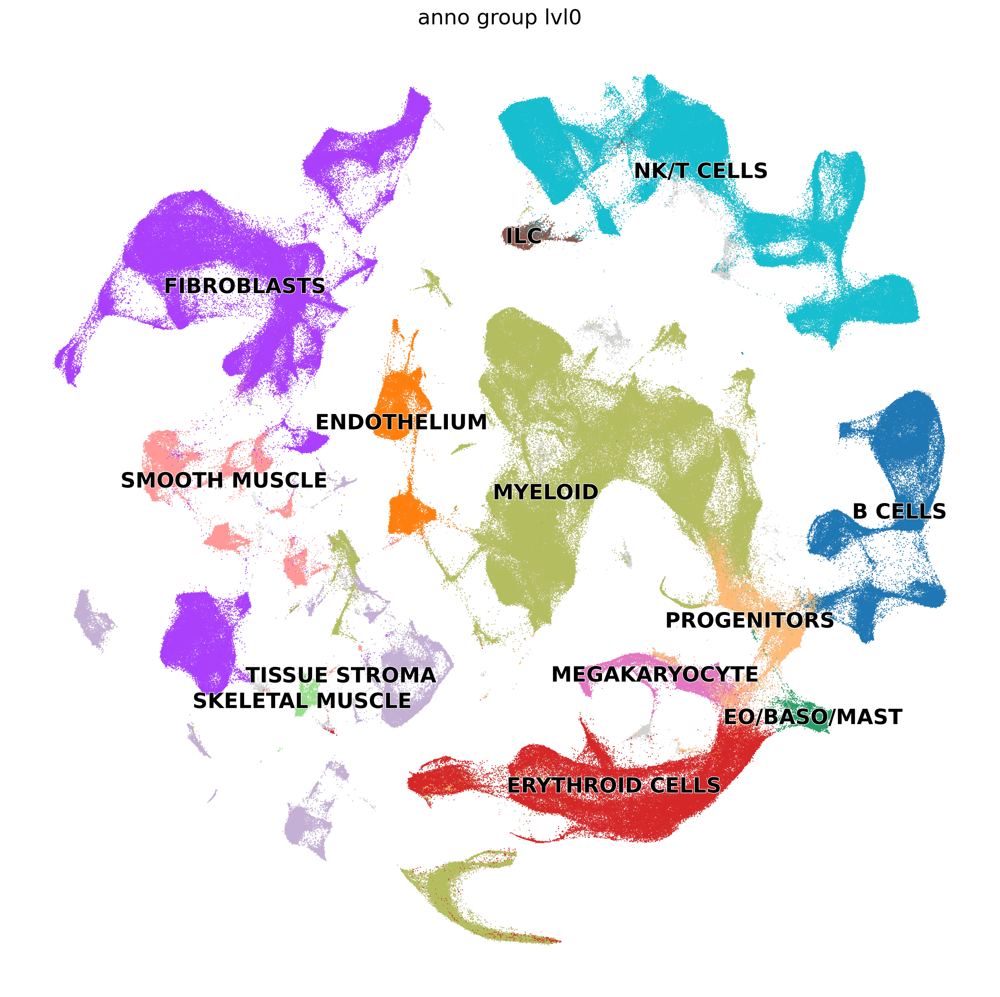

In [33]:
plt.rcParams["figure.figsize"] = [15,15]
scv.pl.umap(adata, color="anno_group_lvl0", legend_loc="on data", size=3, 
#            groups= anno_groups_lvl0["ERYTHROID CELLS"]
           groups = [x for x in anno_groups_lvl0.keys() if x !="OTHER"],palette=sc.plotting.palettes.vega_20_scanpy,
           save="embedding_lineage.pdf"
          )

## UMAP by organ

In [26]:
## load palette
org_colors = pd.read_csv("../../metadata/organ_colors.csv")
org_colors = org_colors[["organ", "color"]]
org_colors.index = org_colors["organ"]

In [27]:
adata.uns["organ_colors"] = org_colors.loc[adata.obs["organ"].cat.categories]["color"].values

In [ ]:
fig, ax = plt.subplots(3,3, figsize=(15,15))
for i in range(len(org_colors.organ)):
    row = int(i/3) 
    col = int(i - (3*row))
    scv.pl.umap(adata, color="organ", groups=org_colors.organ[i], size=3, legend_loc="none", ax=ax[row,col], show=False)
fig.show()

In [ ]:
fig.savefig(figdir + "embedding_organs.pdf")

## Lineage distribution barplots - by organ

#### Split raw numbers by sort

In [21]:
### Fix sort ids
adata.obs["Sort_id"] = ["CD45P" if x == "CD45P_CD45N" else x for x in adata.obs["Sort_id"]]
adata.obs["Sort_id"] = ["CD45N" if x == "CD45EN" else x for x in adata.obs["Sort_id"]]

### Exclude cells from unconventional sorts
adata = adata[adata.obs["Sort_id"].isin(["CD45P", "CD45N", "TOT"])]

In [22]:
adata.obs.Sort_id.value_counts()

CD45P    408671
CD45N    376504
TOT      117199
Name: Sort_id, dtype: int64

In [34]:
lineage_counts = adata.obs[["anno_group_lvl0", "donor","organ", 'sex', 'Sort_id']].groupby(["donor","anno_group_lvl0", "organ", 'Sort_id']).size().reset_index()
lineage_counts.columns = ["donor", "lineage", "organ", 'Sort_id',"n_cells"]

In [35]:
anno_colors = adata.uns['anno_group_lvl0_colors']
anno_names = adata.obs['anno_group_lvl0'].cat.categories
anno_order = ['PROGENITORS', 'MEGAKARYOCYTE','ERYTHROID CELLS', 'EO/BASO/MAST','MYELOID', 'B CELLS', "ILC", 'NK/T CELLS', 
       'ENDOTHELIUM', 'FIBROBLASTS', 'SKELETAL MUSCLE', 'SMOOTH MUSCLE', 'TISSUE STROMA', 'OTHER']

In [36]:
## Save color palette for broad annotation 
# (for spatial plots)
anno_colors_palette = pd.DataFrame(anno_colors, index=anno_names)
anno_colors_palette.columns=['color']
anno_colors_palette.to_csv('../../metadata/broad_annotation_colors.csv')

In [37]:
%%R -i lineage_counts -i anno_names -i anno_colors -i anno_order -i figdir -w 1500 -h 300
organ_order = c("YS", "LI", "BM", "TH", "SP", "MLN", "SK", "KI", "GU")
anno_colors <- setNames(anno_colors, anno_names)

pl <- lineage_counts %>%
#     filter(n_cells > 0) %>%
    mutate(organ=factor(organ, levels=rev(organ_order))) %>%
    mutate(lineage=factor(lineage, levels=rev(anno_order))) %>%
    arrange(lineage) %>%
    mutate(donor=factor(donor, levels=unique(donor))) %>%
    ggplot(aes(organ,n_cells, fill=lineage)) +
    geom_col(position="fill", width=0.8) +
    coord_flip() +
    facet_wrap("Sort_id") +
    scale_fill_manual(values=anno_colors, name="Cellular\ncompartment") +
    guides(fill = guide_legend(reverse=TRUE)) +
    scale_y_continuous(labels=seq(0,100, by=25)) +
    ylab("Composition (%)") +
    theme_classic(base_size=22) 
    
ggsave(paste0(figdir, "broad_organ_composition_sort.pdf"), pl, width=18, height=6)

In [ ]:
%%R
# lineage_counts %>%
# #     filter(n_cells > 0) %>%
#     mutate(organ=factor(organ, levels=rev(organ_order))) %>%
#     mutate(lineage=factor(lineage, levels=rev(anno_order))) %>%
# #     arrange(lineage) %>%
# #     mutate(donor=factor(donor, levels=unique(donor))) %>%
#     filter(is.na(lineage))
pl

#### FACS corrected proportions

In [38]:
facs_prop_df = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/meta_share/220621_FACs_gating_proportions_correct.csv")

## Keep only CD45+ and CD45- cells
facs_prop_df = facs_prop_df[facs_prop_df["sort.ids"].isin(["CD45+", "CD45-"])]

## Distinguish tissues where there have been multiple sorts by the no of total events 
facs_prop_df["sort_sample_id"] = facs_prop_df.origin + "_" + facs_prop_df["orig.ident"] + "_" + facs_prop_df.total_live_events.astype("str")

In [39]:
lineage_counts = adata.obs[["anno_group_lvl0", "donor","organ", 'file', 'Sort_id', 'method']].groupby(['anno_group_lvl0',"donor", "organ", 'file','Sort_id']).count().reset_index()
lineage_counts = lineage_counts.dropna()
lineage_counts.columns = ["lineage","donor", "organ", 'file', 'Sort_id', "n_cells"]

In [40]:
# lineage_counts = adata.obs[["anno_group_lvl0", "donor","organ", 'file', 'Sort_id', 'sex']].groupby(["donor","anno_group_lvl0", "organ", 'file','Sort_id']).size().reset_index()
# lineage_counts.columns = ["donor", "lineage", "organ", 'Sort_id', "n_cells"]
# lineage_counts

**Facs proportion correction:** 
In a sample the number of cells of a given type will be the sum of CD45+ and CD45- cells
$$
n_{true} = n_{+} + n_{-} 
$$
The true number of CD45+ and CD45- cells ($n_+$ and $n_-$) can be estimated from the number of captured cells ($\hat{n}_+$ and $\hat{n}_-$) as follows:
$$
n_{+} = f_{+}\hat{n}_{+} 
$$
where $f_{+}$ is the measured fraction of CD45+ cells. Therefore:

$$
n_{true} = f_{+}\hat{n}_{+} + f_{-}\hat{n}_{-} 
$$

In [41]:
translate_sort_id = {'CD45+':"CD45P", 'CD45-':"CD45N"}
translate_organ = dict(zip(['liver', 'skin', 'fbm', 'gut', 'spleen', 'thymus', 'kidney', 'boneMarrow', 'yolkSac'], 
                           ['LI', "SK", "BM", "GU", "SP", "TH", "KI","BM", "YS"]))
facs_prop_df['Sort_id'] = [translate_sort_id[x] for x in facs_prop_df['sort.ids']]
facs_prop_df['organ'] = [translate_organ[x] for x in facs_prop_df['origin']]
facs_df = facs_prop_df[['Sort_id', "parent_Multiplier", 'orig.ident', 'organ', "Sample.lanes"]]
facs_df.columns = ['Sort_id', "parent_Multiplier", "donor", 'organ', 'file']
# lineage_counts = pd.merge(lineage_counts, facs_df)

lineage_counts_facs = pd.merge(lineage_counts, facs_df, how='left')

In [42]:
## Get corrected n_cell
lineage_counts_facs['corrected_n_cells'] = lineage_counts_facs["n_cells"]*lineage_counts_facs['parent_Multiplier']
# if no FACS info is available, use true count
lineage_counts_facs.loc[lineage_counts_facs['parent_Multiplier'].isna(), 'corrected_n_cells'] = lineage_counts_facs.loc[lineage_counts_facs['parent_Multiplier'].isna(), 'n_cells']

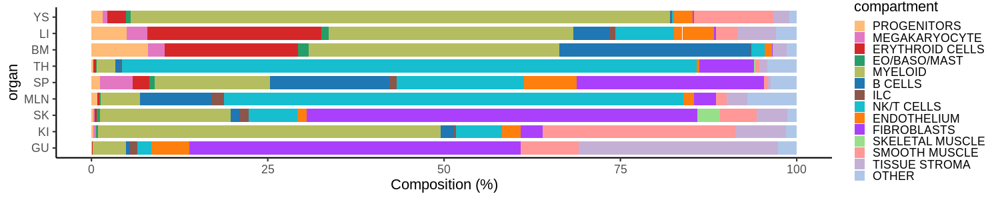

In [43]:
%%R -i lineage_counts_facs -i anno_names -i anno_colors -i anno_order -i figdir -w 1500 -h 300
organ_order = c("YS", "LI", "BM", "TH", "SP", "MLN", "SK", "KI", "GU")
anno_colors <- setNames(anno_colors, anno_names)

lineage_counts_facs %>%
#     filter(n_cells > 0) %>%
    mutate(organ=factor(organ, levels=rev(organ_order))) %>%
    mutate(lineage=factor(lineage, levels=rev(anno_order))) %>%
    arrange(lineage) %>%
    mutate(donor=factor(donor, levels=unique(donor))) %>%
    ggplot(aes(organ,n_cells, fill=lineage)) +
    geom_col(position="fill", width=0.8) +
    coord_flip() +
#     facet_wrap("Sort_id") +
    scale_fill_manual(values=anno_colors, name="Cellular\ncompartment") +
    guides(fill = guide_legend(reverse=TRUE)) +
    scale_y_continuous(labels=seq(0,100, by=25)) +
    ylab("Composition (%)") +
    theme_classic(base_size=22) 
    
# ggsave(paste0(figdir, "broad_organ_composition_sort.pdf"), pl, width=18, height=6)

In [44]:
%%R -i lineage_counts_facs -i anno_names -i anno_colors -i anno_order -i figdir -h 800 -w 600
organ_order = c("YS", "LI", "BM", "TH", "SP", "MLN", "SK", "KI", "GU")
anno_colors <- setNames(anno_colors, anno_names)

pl <- lineage_counts_facs %>%
#     filter(n_cells > 0) %>%
    mutate(organ=factor(organ, levels=organ_order)) %>%
    mutate(lineage=factor(lineage, levels=anno_order)) %>%
    arrange(lineage) %>%
    mutate(donor=factor(donor, levels=unique(donor))) %>%
    ggplot(aes(organ,corrected_n_cells, fill=lineage)) +
    geom_col(position="fill", width=0.8) +
#     coord_flip() +
#     facet_wrap("Sort_id") +
    scale_fill_manual(values=anno_colors, name="Cellular\ncompartment") +
    guides(fill = guide_legend(reverse=FALSE)) +
    scale_y_continuous(labels=seq(0,100, by=25)) +
    ylab("Composition (%)") +
    theme_classic(base_size=28) +
    theme(axis.text.x=element_text(angle=45, hjust=1, vjust=1))
    
ggsave(paste0(figdir, "broad_organ_composition_FACScorrected_vertical.pdf"), pl, width=8, height=10)

## Lineage distribution barplots - by age

In [45]:
age_df = adata.obs[['donor','age']].drop_duplicates()
age_df.index = age_df['donor']
age_df.index.name = None

In [46]:
lineage_counts = pd.merge(lineage_counts, age_df)

In [69]:
translate_sort_id = {'CD45+':"CD45P", 'CD45-':"CD45N"}
translate_organ = dict(zip(['liver', 'skin', 'fbm', 'gut', 'spleen', 'thymus', 'kidney', 'boneMarrow', 'yolkSac'], 
                           ['LI', "SK", "BM", "GU", "SP", "TH", "KI","BM", "YS"]))
facs_prop_df['Sort_id'] = [translate_sort_id[x] for x in facs_prop_df['sort.ids']]
facs_prop_df['organ'] = [translate_organ[x] for x in facs_prop_df['origin']]
facs_df = facs_prop_df[['Sort_id', "parent_Multiplier", 'orig.ident', 'organ', "Sample.lanes"]]
facs_df.columns = ['Sort_id', "parent_Multiplier", "donor", 'organ', 'file']
# lineage_counts = pd.merge(lineage_counts, facs_df)

lineage_counts_facs = pd.merge(lineage_counts, facs_df, how='left')

In [70]:
## Get corrected n_cell
lineage_counts_facs['corrected_n_cells'] = lineage_counts_facs["n_cells"]*lineage_counts_facs['parent_Multiplier']
# if no FACS info is available, use true count
lineage_counts_facs.loc[lineage_counts_facs['parent_Multiplier'].isna(), 'corrected_n_cells'] = lineage_counts_facs.loc[lineage_counts_facs['parent_Multiplier'].isna(), 'n_cells']

In [71]:
lineage_counts_facs.age = lineage_counts_facs.age.astype("int")

In [74]:
## Split gestational age into bins
cut_labels_4 = ['< 8pcw', '< 10pcw', '< 12pcw', '< 14pcw', '< 16pcw', '< 18pcw']
cut_bins = [0, 8, 10, 12, 14, 16, 18]

lineage_counts_facs["age_bins"] = pd.cut(lineage_counts_facs["age"], bins=cut_bins, labels=cut_labels_4).astype("str")
lineage_counts_facs["age_bins"] = pd.Categorical(lineage_counts_facs["age_bins"], categories=cut_labels_4, ordered=True)

## Exclude early TH samples
lineage_counts_facs = lineage_counts_facs[~((lineage_counts_facs["age_bins"].isin(['< 8pcw', '< 10pcw'])) & (lineage_counts_facs.organ == 'TH')) ]

In [66]:
# ## Keep bin - organ combination if there are at least 2 donors
# count_donors = lineage_counts_facs[['organ', 'age_bins', 'donor']].drop_duplicates()
# count_donors = count_donors.groupby(['organ', 'age_bins']).size().reset_index()
# count_donors.columns = ['organ', 'age_bins', 'n_donors']
# lineage_counts_facs = pd.merge(lineage_counts_facs, count_donors)

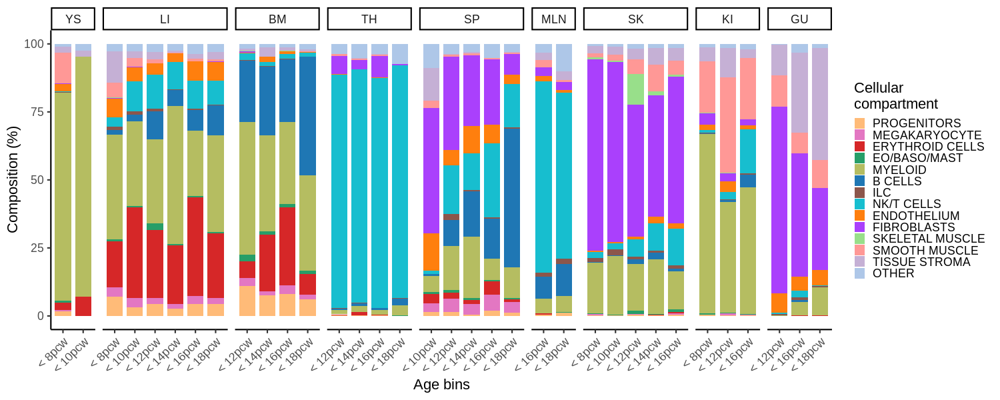

In [75]:
%%R -i lineage_counts_facs -i anno_names -i anno_colors -i anno_order -i figdir -w 1500 -h 600
organ_order = c("YS", "LI", "BM", "TH", "SP", "MLN", "SK", "KI", "GU")
anno_colors <- setNames(anno_colors, anno_names)

lineage_counts_facs %>%
    mutate(lineage=factor(lineage, levels=rev(anno_order))) %>%
    mutate(organ=factor(organ, levels=organ_order)) %>%
    arrange(lineage) %>%
    mutate(donor=factor(donor, levels=unique(donor))) %>%
    ggplot(aes(age_bins, n_cells, fill=lineage)) +
    geom_col(position="fill", width=0.8) +
    scale_fill_manual(values=anno_colors, name="Cellular\ncompartment") +
    guides(fill = guide_legend(reverse=TRUE)) +
    scale_y_continuous(labels=seq(0,100, by=25)) +
    ylab("Composition (%)") + xlab("Age bins") +
    theme_classic(base_size=22) +
    facet_grid(.~organ, scales='free', space='free') +
    theme(axis.text.x=element_text(angle=45, hjust=1, vjust=1)) +
    ggsave(paste0(figdir, "broad_organ_composition_sort_byage.pdf"), width=18, height=6)

## UMAP + metadata

In [42]:
adata.obs["age"] = adata.obs["age"].astype("int")

In [43]:
scv.settings.figdir = figdir

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/embedding_figures/scvelo_metadata_embeddings.pdf


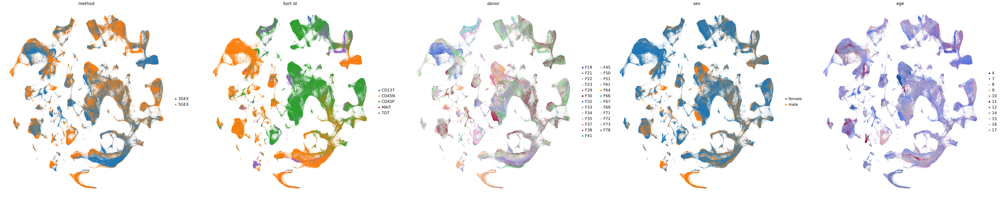

In [44]:
scv.pl.umap(adata, color=['method', "Sort_id", "donor", "sex", "age"], legend_loc="right margin", size=3, save="metadata_embeddings.pdf")

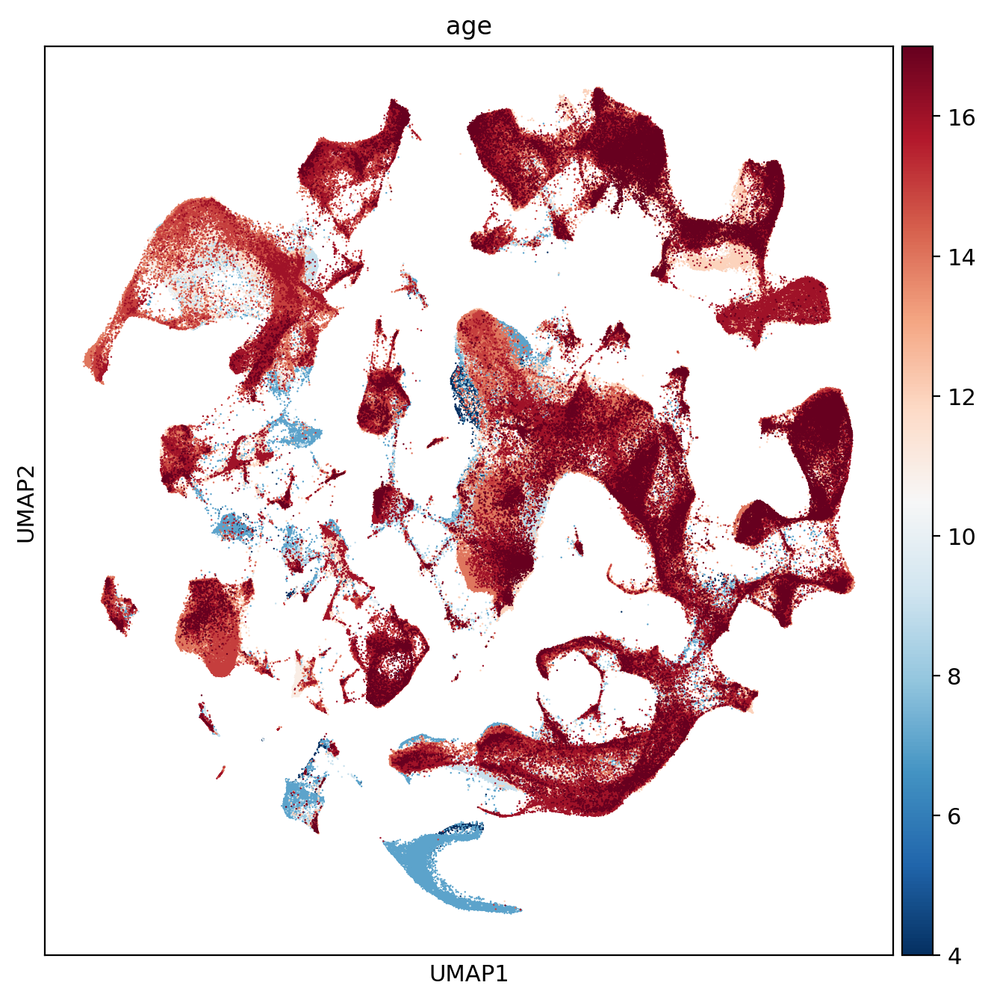

In [383]:
adata.obs["age"] = adata.obs["age"].astype("int")
sc.pl.umap(adata, color=["age"], legend_loc="right margin", size=3, save="age_embeddings.pdf", sort_order=False)

Check sex with XIST expression

In [66]:
xist_df = adata.obs[['file', 'sex']].copy()
xist_df['XIST_gex'] = adata[:,"XIST"].X.toarray()

xist_mean_df = xist_df.groupby(['file']).mean('XIST_gex').reset_index()
xist_mean_df = pd.merge(xist_mean_df, xist_df[['file', 'sex']].drop_duplicates(), how='left')

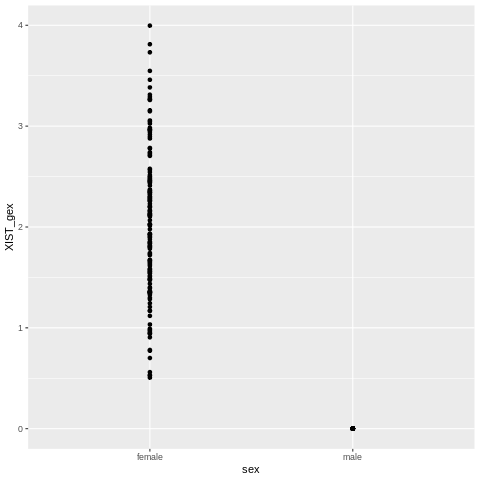

In [68]:
%%R -i xist_mean_df
xist_mean_df %>%
    ggplot(aes(sex, XIST_gex)) +
    geom_point()

## Illustration of splits for annotation

In [103]:
def load_scvi_outs(adata, emb_file, load_clustering=True):
    X_scVI_emb = np.load(emb_file)
    X_scVI_umap = np.load(emb_file.rstrip(".npy") + ".UMAP.npy")
    adata.obsm["X_scvi"] = X_scVI_emb
    adata.obsm["X_umap"] = X_scVI_umap
    if load_clustering:
        X_scVI_clust = pd.read_csv(emb_file.rstrip(".npy") + ".clustering.csv", index_col=0)
        adata.obs["scvi_clusters"] = X_scVI_clust.loc[adata.obs_names]["leiden_150"].astype("category")

def load_data_split(data_dir, timestamp, split):
    # Load estimated gene dispersions for HVG selection
    # Generated running `Pan_fetal_immune/utils/PFI_pp_4_HVG_stats.py`
    adata_lognorm_var = pd.read_csv(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.var.csv'.format(t=timestamp, s=split), index_col=0)

    ### Load gex data
    adata_raw = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.h5ad'.format(t=timestamp, s=split))
    adata_raw.var_names_make_unique()

    # Load obs
    new_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.csv".format(t=timestamp), index_col=0)
    adata_raw.obs = new_obs.loc[adata_raw.obs_names]

    ## Load var
    adata_raw.var = adata_lognorm_var.copy()

    ## Add batch key
    adata_raw.obs["bbk"] = adata_raw.obs["method"] + adata_raw.obs["donor"]
    return(adata_raw)

In [92]:
adata = adata.copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [12]:
[anno[x] for x in adata.obs['anno_lvl_2_final_clean']]

FCAImmP7579224-ATTACTCTCGATGAGG          CYCLING_DC
FCAImmP7579224-CAGCCGAGTACATCCA           EARLY_ERY
FCAImmP7579224-TGCTACCTCATGTAGC             PRE_DC2
FCAImmP7579224-ACGGCCACAAGCTGAG    MONOCYTE_II_CCR2
FCAImmP7579224-CTAATGGCACTGTGTA         LARGE_PRE_B
                                         ...       
FCAImmP7803042-AGTGGGAGTCGACTGC     FIBROBLAST_XIII
FCAImmP7803042-CCATTCGTCAACACAC        FIBROBLAST_V
FCAImmP7803042-CGTAGCGAGTGACATA        FIBROBLAST_I
FCAImmP7803042-TGGCCAGCAATGAAAC       FIBROBLAST_IV
FCAImmP7803042-ATTGGACAGGAGTACC        KERATINOCYTE
Name: anno_lvl_2_final_clean, Length: 911873, dtype: category
Categories (138, object): ['ABT(ENTRY)', 'AS_DC', 'B1', 'CD4+T', ..., 'VSMC_PERICYTE_II', 'VSMC_PERICYTE_III', 'YS_ERY', 'YS_STROMA']

In [104]:
show_splits = ['STROMA','HSC_IMMUNE', "MYELOID_V2", "LYMPHOID", "MEM_PROGENITORS", "NKT", 'HSC_PROGENITORS']

In [155]:
data_dir="/nfs/team205/ed6/data/Fetal_immune/"
timestamp="20210429"
split_dict = {}
for split in show_splits:
    if split != 'MEM_PROGENITORS':
        adata_spl = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.h5ad'.format(t=timestamp, s=split), backed='r')
    else:
        adata_spl = load_data_split(data_dir, timestamp, split)
    split_dict[split] = {'cells':adata_spl.obs_names, 'embedding':adata_spl.obsm['X_umap']}
        

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [112]:
split_hierarchy = {'STROMA':{},
 'HSC_IMMUNE': {"MYELOID_V2":{}, 
                "LYMPHOID":{"NKT"}, 
                "MEM_PROGENITORS":{}, 
                'HSC_PROGENITORS':{}}}

... storing 'isin_STROMA' as categorical


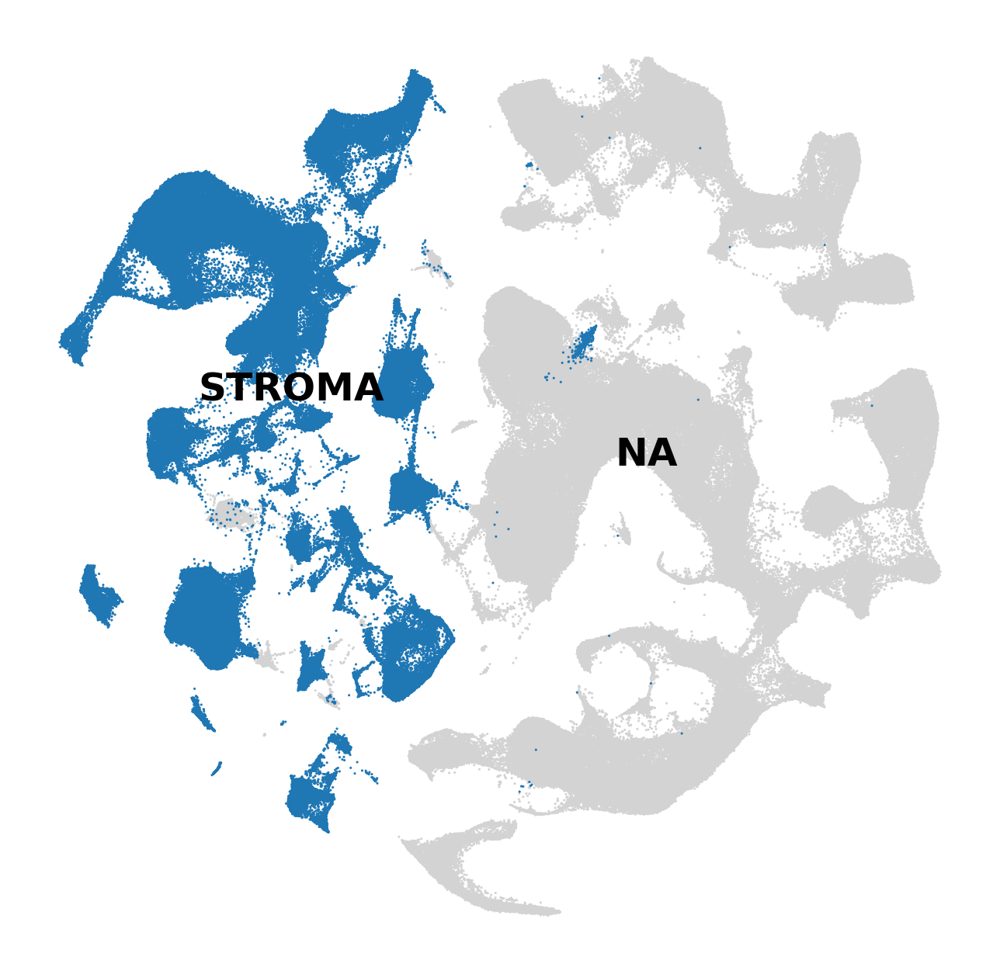

... storing 'isin_HSC_IMMUNE' as categorical


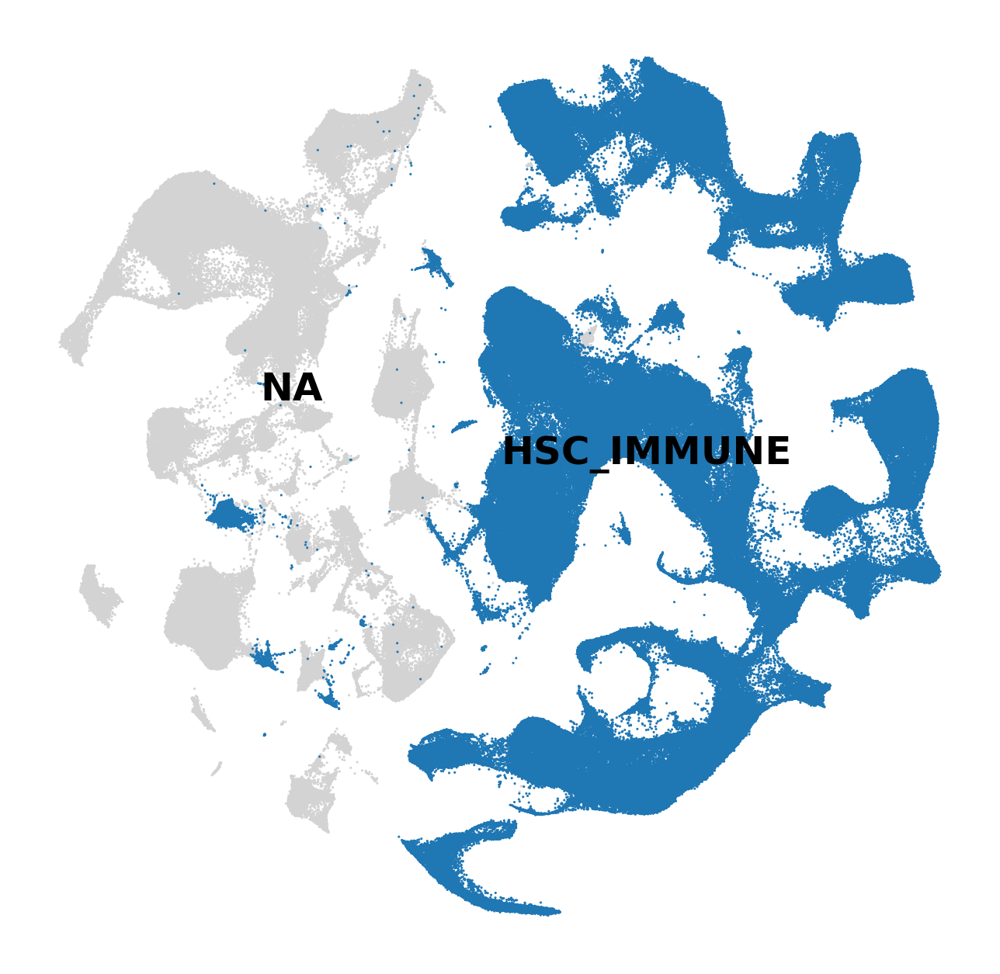

In [159]:
plt.rcParams['figure.figsize'] = [8,8]
for spl in split_hierarchy.keys():
    adata.obs['isin_' + spl] = [spl if x in split_dict[spl]['cells'] else np.nan for x in adata.obs_names]
    sc.pl.umap(adata, color='isin_' + spl, size=5, frameon=False, legend_loc='on data', groups=[spl], title='', 
              save='annotation_hierarchy_'+spl+'.pdf')

... storing 'isin_MYELOID_V2' as categorical


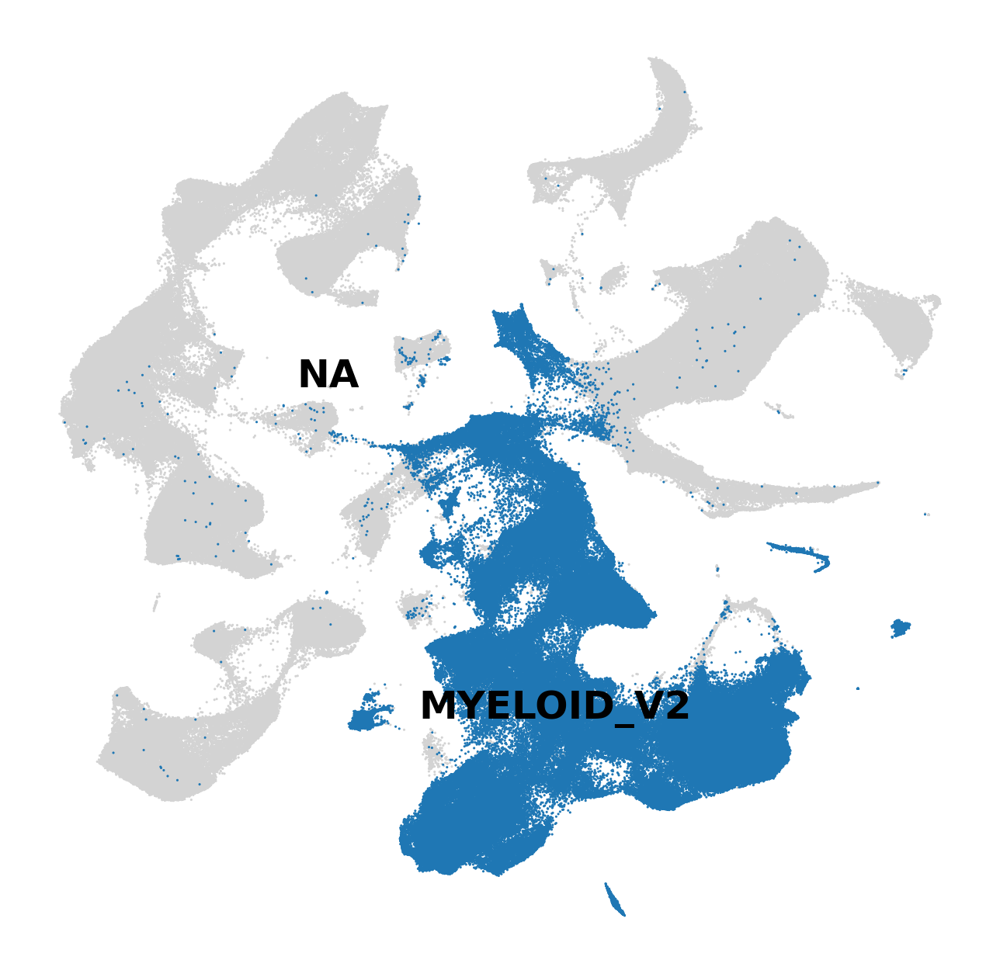

... storing 'isin_LYMPHOID' as categorical


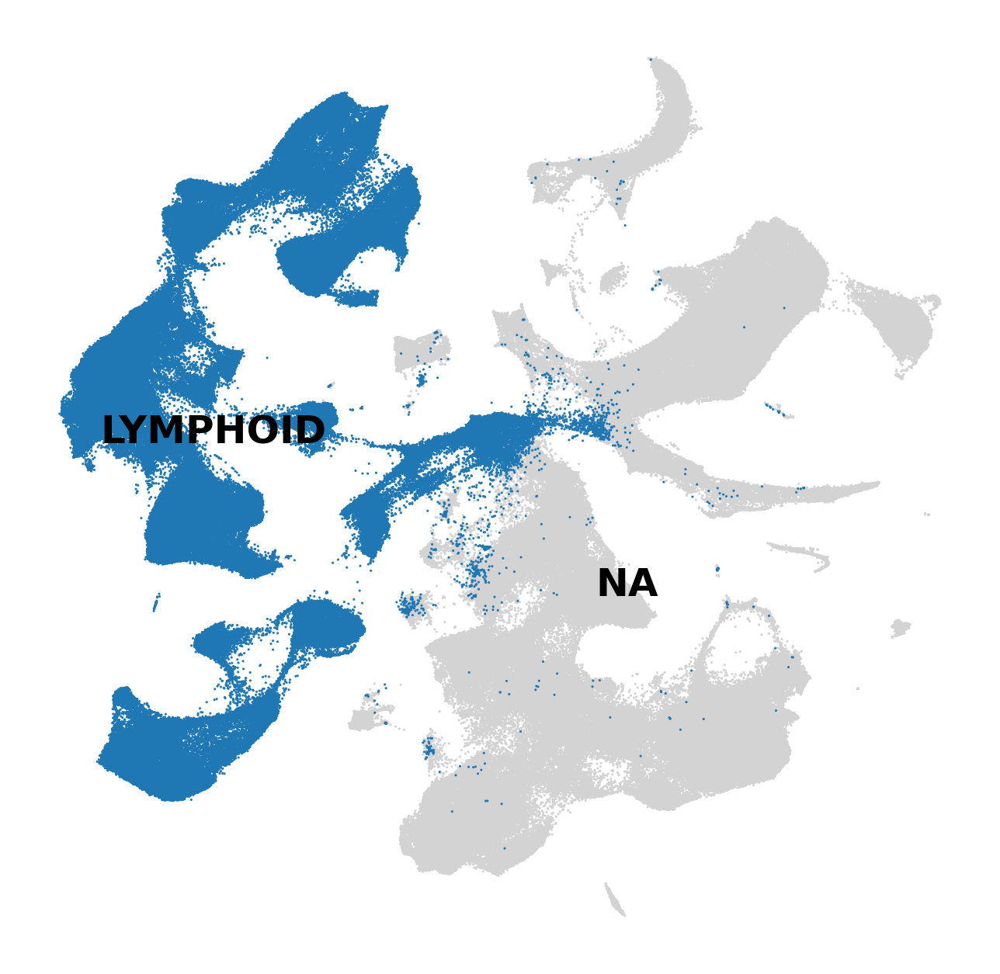

... storing 'isin_MEM_PROGENITORS' as categorical


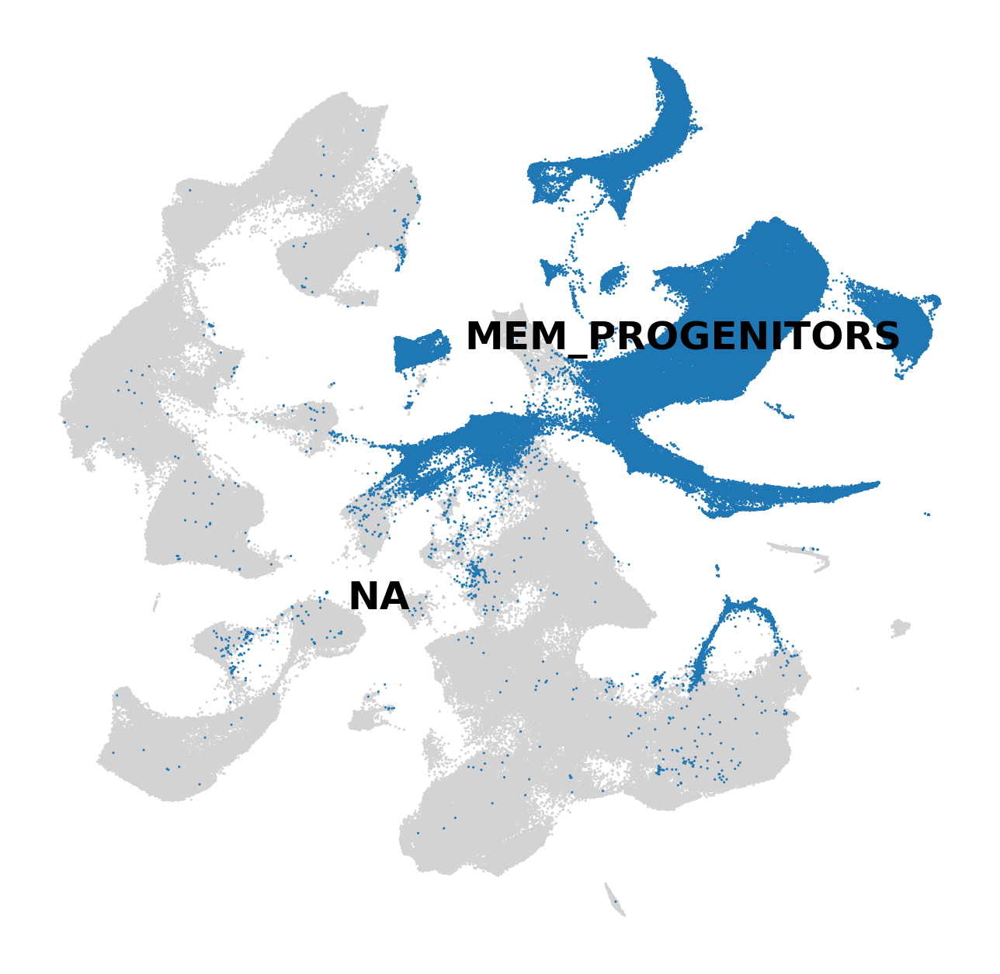

... storing 'isin_HSC_PROGENITORS' as categorical


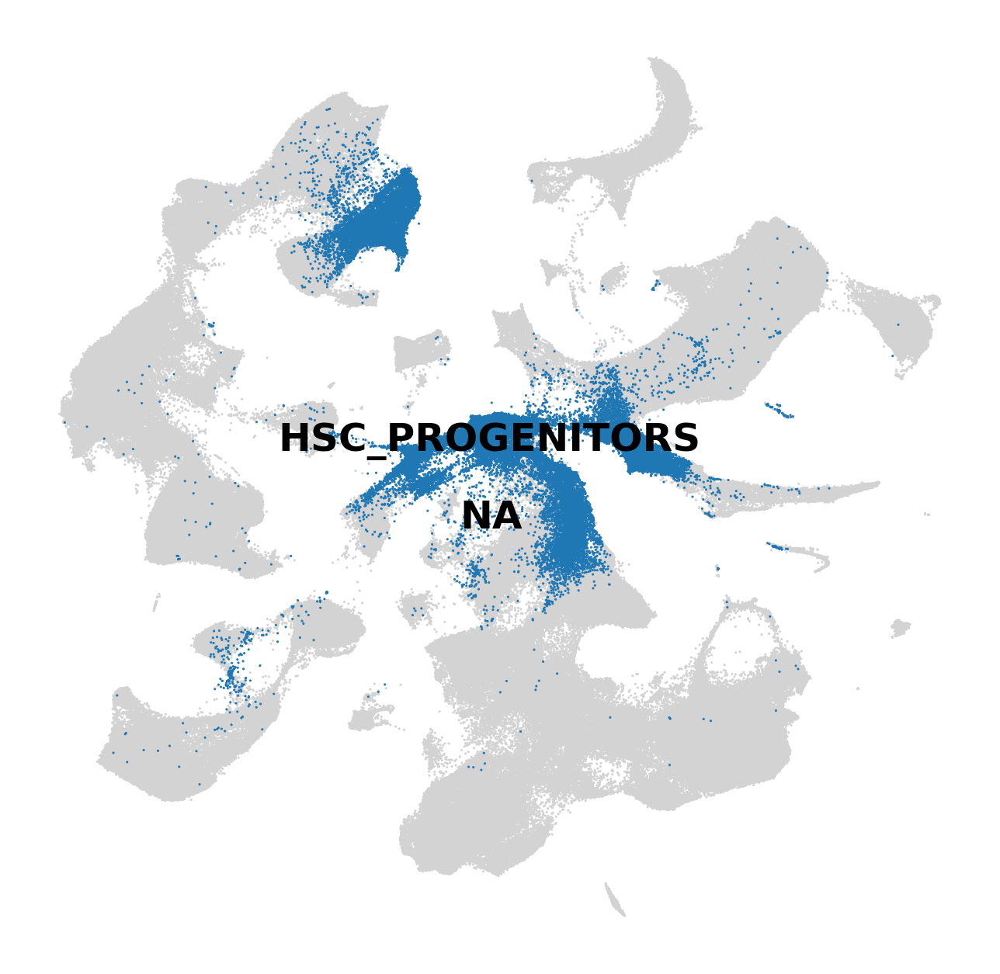

In [160]:
emb_spl = "HSC_IMMUNE"

split_embedding = anndata.AnnData(obs = split_dict[emb_spl]['embedding'])
split_embedding.obsm["X_umap"] = split_dict[emb_spl]['embedding'].copy()
split_embedding.obs_names = split_dict[emb_spl]['cells'].copy()

plt.rcParams['figure.figsize'] = [8,8]
for spl in split_hierarchy[emb_spl].keys():
    split_embedding.obs['isin_' + spl] = [spl if x in split_dict[spl]['cells'] else np.nan for x in split_embedding.obs_names]
    sc.pl.umap(split_embedding, color='isin_' + spl, size=5, frameon=False, legend_loc='on data', groups=[spl], title='',
              save='annotation_hierarchy_embedding'+emb_spl +'_color'+spl+'.pdf')

... storing 'isin_NKT' as categorical


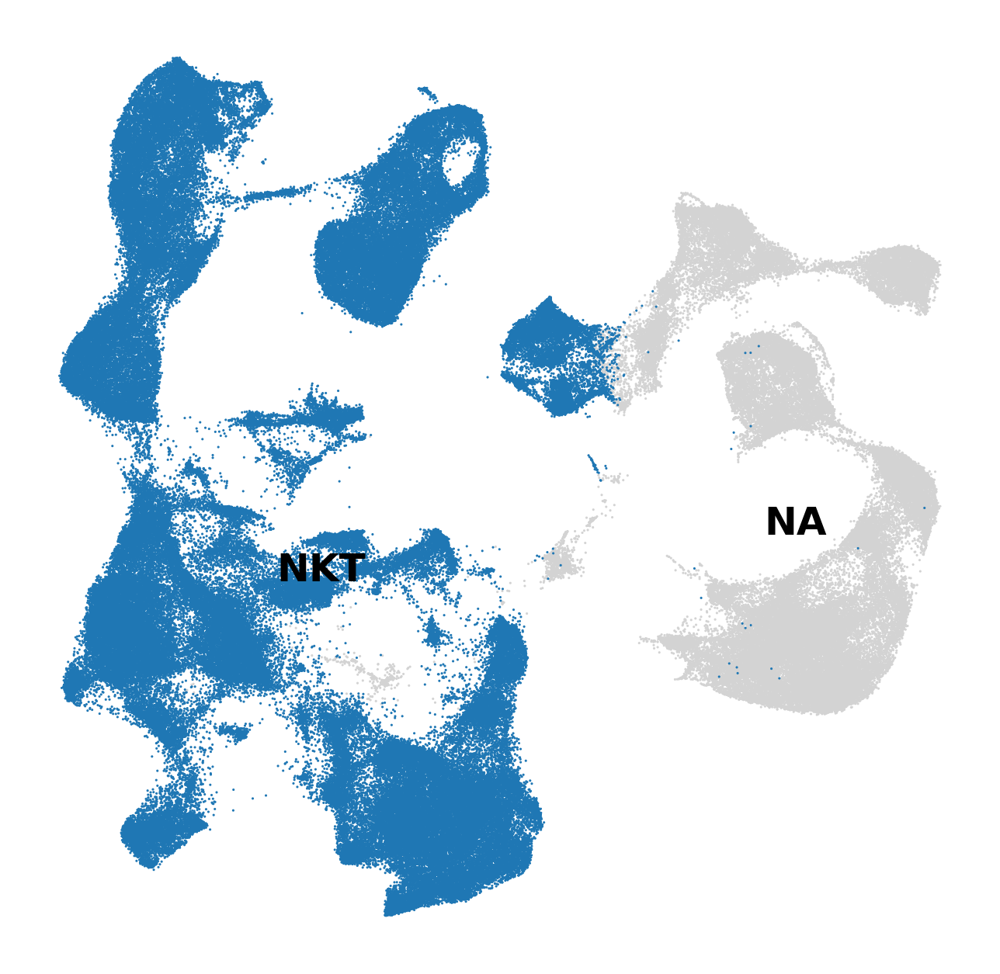

In [166]:
emb_spl = "LYMPHOID"

split_embedding = anndata.AnnData(obs = split_dict[emb_spl]['embedding'])
split_embedding.obsm["X_umap"] = split_dict[emb_spl]['embedding'].copy()
split_embedding.obs_names = split_dict[emb_spl]['cells'].copy()

plt.rcParams['figure.figsize'] = [8,8]
for spl in split_hierarchy['HSC_IMMUNE'][emb_spl]:
    split_embedding.obs['isin_' + spl] = [spl if x in split_dict[spl]['cells'] else np.nan for x in split_embedding.obs_names]
    sc.pl.umap(split_embedding, color='isin_' + spl, size=5, frameon=False, legend_loc='on data', groups=[spl], title='',
              save='annotation_hierarchy_embedding'+emb_spl +'_color'+spl+'.pdf')

## Visualize cells that have antigen-receptor info

In [ ]:
# output_dir = data_dir + 'cellxgene_h5ad_files/scRNA_data/'
# adata = sc.read_h5ad(output_dir + 'PAN.A01.v01.raw_count.{t}.PFI.embedding.h5ad'.format(t=timestamp), backed='r')

In [10]:
adata_tcr = sc.read_h5ad('/lustre/scratch117/cellgen/team205/cs42/panfetal/PAN.A01.v01.entire_data_normalised_log.20210429.VDJ.h5ad',
                        backed='r')
# vdj_obs_names = adata_tcr.obs_names[adata_tcr.obs.has_contig!='no contig']


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [11]:
adata_tcr

AnnData object with n_obs × n_vars = 911873 × 33538 backed at '/lustre/scratch117/cellgen/team205/cs42/panfetal/PAN.A01.v01.entire_data_normalised_log.20210429.VDJ.h5ad'
    obs: 'n_counts', 'n_genes', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'leiden_150', 'scvi_clusters', 'bcr-filter_rna', 'bcr-has_contig', 'bcr-filter_contig_quality', 'bcr-filter_contig_VDJ', 'bcr-filter_contig_VJ', 'bcr-contig_QC_pass', 'bcr-filter_contig', 'bcr-clone_id', 'bcr-clone_id_by_size', 'bcr-sample_id', 'bcr-locus_VDJ', 'bcr-locus_VJ', 'bcr-productive_VDJ', 'bcr-productive_VJ', 'bcr-v_call_genotyped_VDJ', 'bcr-v_call_genotyped_VJ', 'bcr-d_call_VDJ', 'bcr-j_call_VDJ', 'bcr-j_call_VJ', 'bcr-c_call_VDJ', 'bcr-c_call_VJ', 'bcr-duplicate_count_VDJ', 'bcr-duplicate_count_VJ', 'bcr-duplicate_count_VDJ_1', 'bcr-duplicate_count_VJ_1', 'bcr-duplicate_count_VDJ_2', 'bcr-duplicate_count_VDJ_3', 'bcr-junction_aa_VDJ', 'bcr-junction_aa_VJ', 'bcr-locus_status', 'bcr-locus_status_summary', 'bcr-prod

In [27]:
[x for x in adata_tcr.obs.columns if 'status_summary' in x]

['locus_status_summary', 'vdj_status_summary', 'constant_status_summary']

In [29]:
# tcr_input_dir = data_dir + 'cellxgene_h5ad_files/scVDJ_data/'
tcr_input_dir = '/lustre/scratch117/cellgen/team205/cs42/panfetal/cellxgene/'
for vdj_type in ["BCR", "abTCR", "gdTCR"]:
    if vdj_type == 'BCR':
        adata_tcr = sc.read_h5ad(tcr_input_dir + "PAN.A01.v01.raw_count.20210429.LYMPHOID.embedding.BCR.h5ad")
        vdj_obs_names = adata_tcr.obs_names[adata_tcr.obs.locus_status_summary.isin(['IGH + IGK','IGH + IGL'])]
    else:
        adata_tcr = sc.read_h5ad(tcr_input_dir + "PAN.A01.v01.raw_count.20210429.NKT.embedding.{v}.h5ad".format(v=vdj_type))
        if vdj_type=='gdTCR':
            cond1 = adata_tcr.obs.chain_pairing.isin(['single pair','extra VJ','extra VDJ','two full chains'])
            cond2 = adata_tcr.obs.receptor_subtype=='TRG+TRD'   
            vdj_obs_names = adata_tcr.obs_names[cond1 & cond2]
        else:
            vdj_obs_names = adata_tcr.obs_names[adata_tcr.obs.chain_pairing.isin(['single pair','extra VJ','extra VDJ','two full chains'])]
    adata.obs['has_paired_{v}'.format(v=vdj_type)] = adata.obs_names.isin(vdj_obs_names).astype('int')

In [ ]:
adata.obs['anno_group'] = [anno_groups_dict_rev[x] if type(x)==str else np.nan for x in adata.obs['anno_lvl_2_final_clean']]

In [30]:
adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR']].sum()

has_paired_abTCR    28582
has_paired_gdTCR      800
has_paired_BCR      14506
dtype: int64

In [31]:
adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR']] = adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR']].astype('int')

In [46]:
adata.obs['paired_bcr_tcr'] = adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR']].idxmax(1)
adata.obs['paired_bcr_tcr'] = [x[-1] for x in adata.obs['paired_bcr_tcr'].str.split("has_paired_")]
adata.obs.loc[adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR']].max(1) == 0, 'paired_bcr_tcr'] = np.nan

In [40]:
scv.settings.figdir = figdir

... storing 'paired_bcr_tcr' as categorical


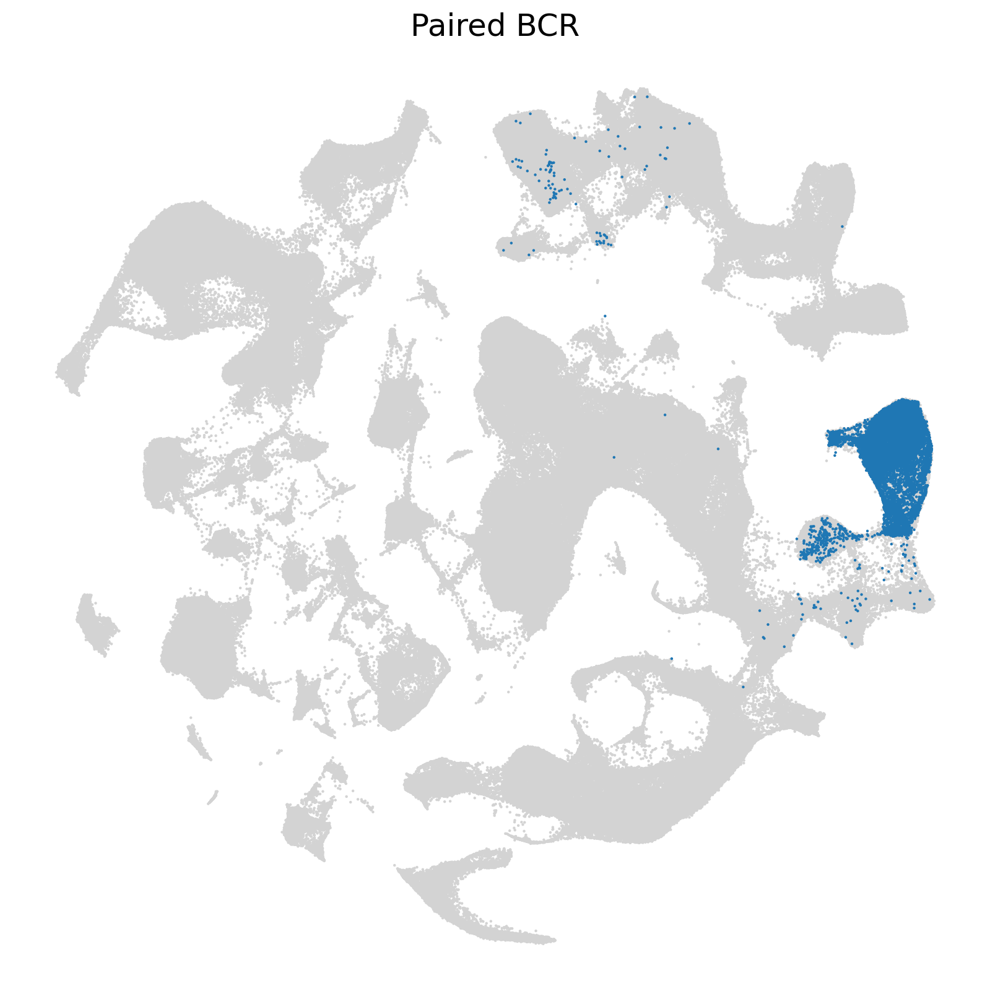

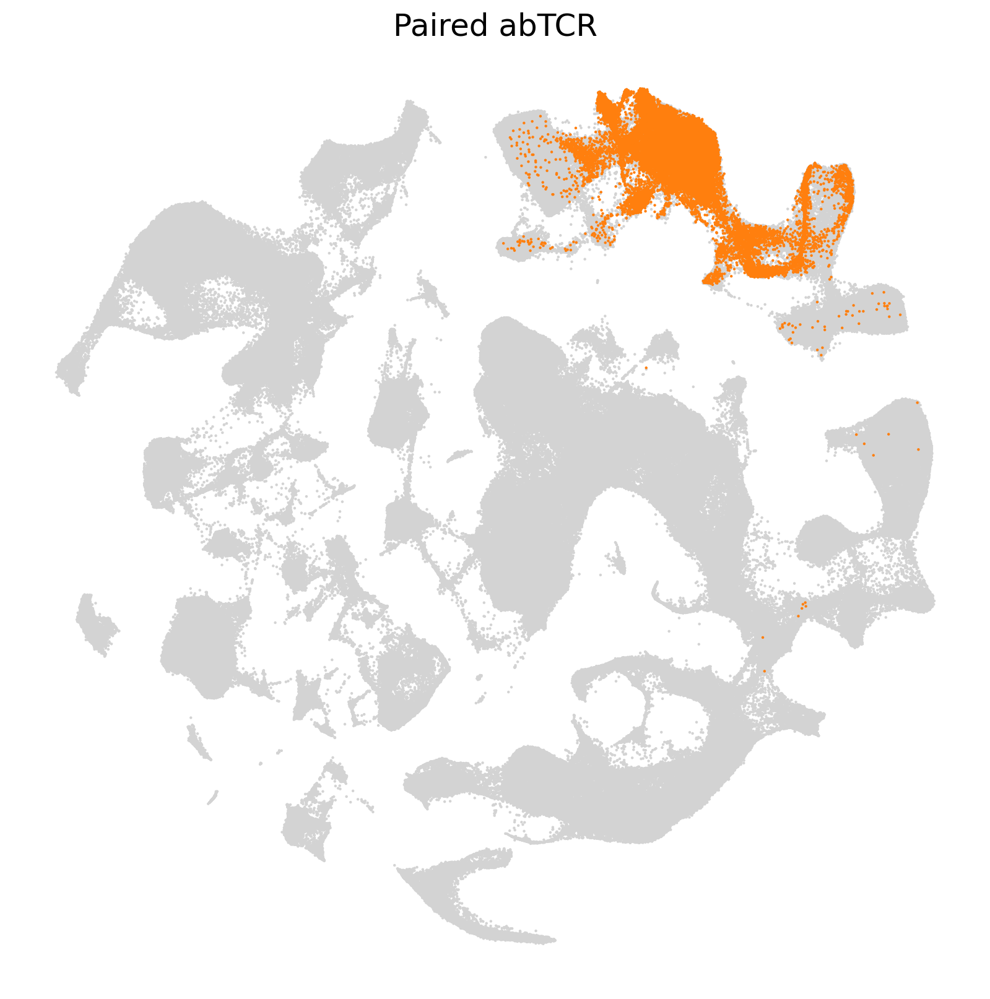

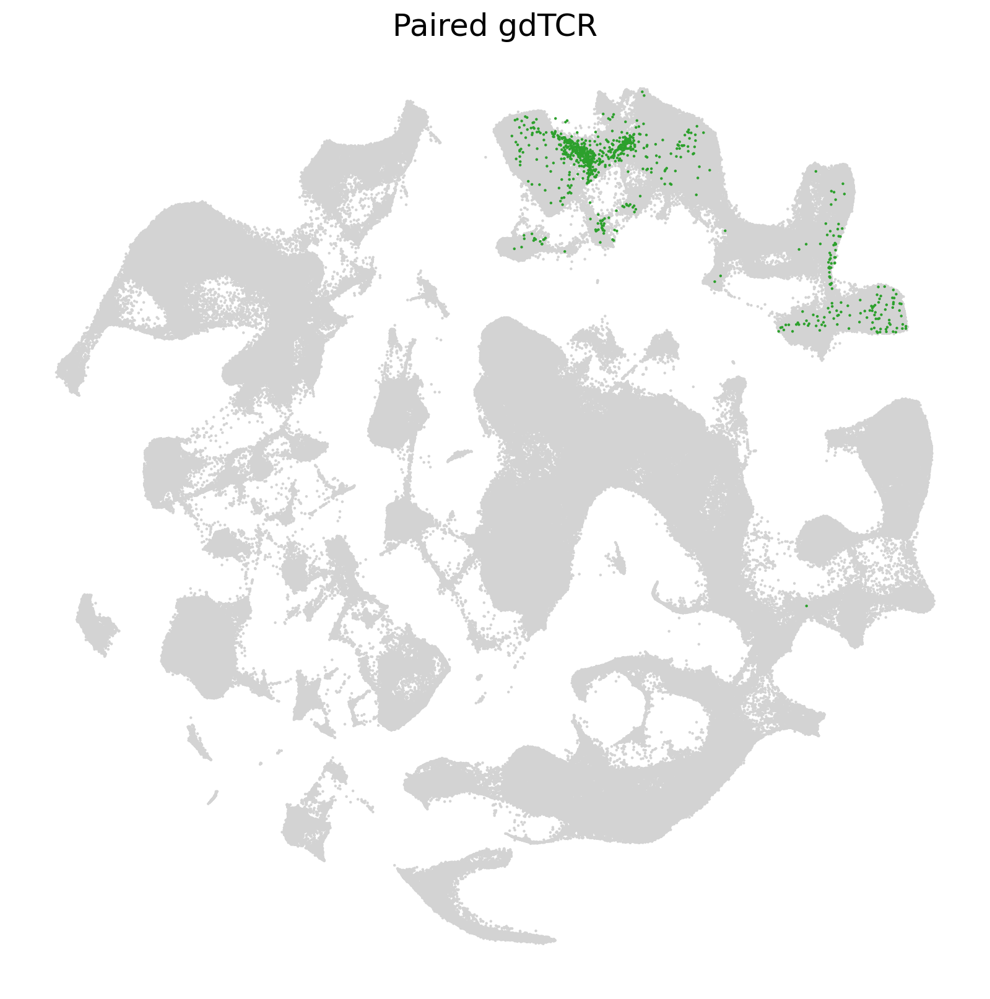

In [47]:
plt.rcParams['figure.figsize'] = [10,10]
sc.pl.umap(adata, color=['paired_bcr_tcr'], 
            size=10, cmap='magma', frameon=False, groups=['BCR'],legend_loc='none',
           title='Paired BCR',
            save="has_bcr_embeddings.pdf"
          )
sc.pl.umap(adata, color=['paired_bcr_tcr'], 
            size=10, cmap='magma', frameon=False, groups=['abTCR'],legend_loc='none',
           title='Paired abTCR',
            save="has_abtcr_embeddings.pdf"
          )
sc.pl.umap(adata, color=['paired_bcr_tcr'], 
            size=10, cmap='magma', frameon=False, groups=['gdTCR'],legend_loc='none',
           title='Paired gdTCR',
            save="has_gdtcr_embeddings.pdf"
          )

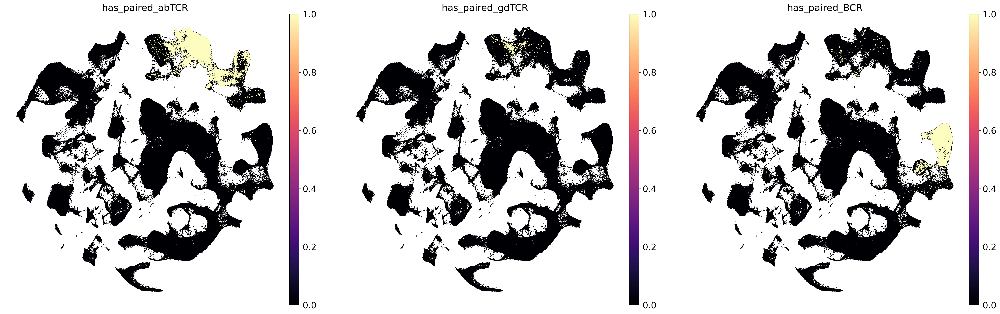

In [101]:
plt.rcParams['figure.figsize'] = [10,10]
sc.pl.umap(adata, color=['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR'], 
            size=10, cmap='magma', frameon=False,
            save="has_vdj_embeddings.pdf")

In [113]:
prop_vdj = adata.obs[['has_VDJ_abTCR','has_VDJ_gdTCR','has_VDJ_BCR', 'anno_group']]
n_vdj = prop_vdj.groupby('anno_group').sum()
size_vdj = prop_vdj.groupby('anno_group').size()

In [115]:
n_vdj

,has_VDJ_abTCR,has_VDJ_gdTCR,has_VDJ_BCR
anno_group,,,
B CELLS,1,0,14081
ERYTHROID CELLS,0,0,0
ILC,58,9,2
MYELOID,0,0,2
NK/T CELLS,27619,515,68
OTHER,901,3,742
PROGENITORS,3,0,8
STROMA,0,0,0


In [114]:
n_vdj.T/size_vdj

anno_group,B CELLS,ERYTHROID CELLS,ILC,MYELOID,NK/T CELLS,OTHER,PROGENITORS,STROMA
has_VDJ_abTCR,0.000016,0.0,0.008357,0.000000,0.182769,0.038910,0.000138,0.0
has_VDJ_gdTCR,0.000000,0.0,0.001297,0.000000,0.003408,0.000130,0.000000,0.0
has_VDJ_BCR,0.219954,0.0,0.000288,0.000008,0.000450,0.032044,0.000368,0.0


Number of libraries with VDJ sequencing

In [110]:
(adata.obs[['has_paired_abTCR','has_paired_gdTCR','has_paired_BCR', 'file']].groupby('file').sum()!=0).sum()

has_paired_abTCR    57
has_paired_gdTCR    16
has_paired_BCR      39
dtype: int64

In [112]:
61/221

0.27601809954751133

## Consistency of cts across donors

In [76]:
org_count_df = anno_obs.groupby(["organ",'donor', "anno_lvl_2_final_clean"]).count()['file'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
org_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in org_count_df.anno_lvl_2_final_clean]
org_count_df.loc[org_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
org_count_df["anno"] = org_count_df["anno_lvl_2_final_clean"]

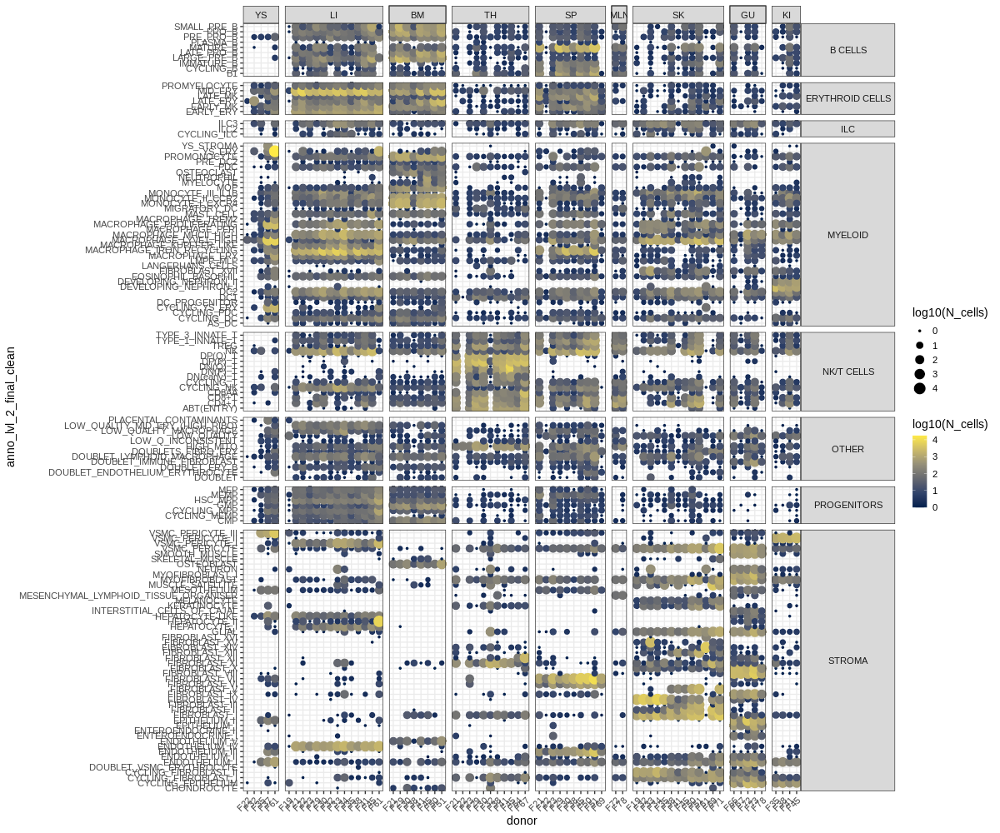

In [78]:
%%R -i org_count_df --i figdir -w 1200 -h 1000 -i org_colors
org_count_df %>%
    rename(N_cells=file) %>%
    mutate(organ=factor(organ, levels=rownames(org_colors))) %>%
  ggplot(aes(donor, anno_lvl_2_final_clean)) +
    geom_point(aes(color=log10(N_cells), size=log10(N_cells))) +
    facet_grid(anno_group~organ, space="free", scales="free") +
    scale_color_viridis_c(option='cividis') +
    theme_bw(base_size=14) +
    theme(strip.text.y=element_text(angle=0), axis.text.x=element_text(angle=45, vjust=1, hjust=1)) 